### Gaussian Processes Practical Demonstration
https://www.youtube.com/watch?v=V1bF37-_ytQ

In [1]:
# Support for maths
import numpy as np
# Plotting tools
from matplotlib import pyplot as plt
# we use the following for plotting figures in jupyter
%matplotlib inline
# Importing data library
import pandas as pd

import warnings
warnings.filterwarnings('ignore')

# GPy: Gaussian processess libary
import GPy
from IPython.display import display

plt.rcParams.update({'font.size': 32})

In [2]:
# Pembacaan File Data Polusi Udara ISPU Excel
DKI1 = pd.read_excel("./Data/Normalization/DATA ISPU - Normalization.xlsx", sheet_name="DKI1")

In [3]:
# Menampilkan 5 Data pertama DKI1
DKI1.head()

,Tanggal,Wilayah,PM10,SO2,CO,O3,NO2,Max,Critical,Kategori
0,2017-01-01,DKI1 (Bunderan HI),0.719512,0.314286,0.458333,0.092308,0.012821,0.300518,PM10,Sedang
1,2017-01-02,DKI1 (Bunderan HI),0.146341,0.295238,0.270833,0.082051,0.000000,0.139896,SO2,Baik
2,2017-01-03,DKI1 (Bunderan HI),0.170732,0.295238,0.291667,0.087179,0.012821,0.139896,SO2,Baik
3,2017-01-04,DKI1 (Bunderan HI),0.243902,0.295238,0.395833,0.087179,0.012821,0.139896,SO2,Baik
4,2017-01-05,DKI1 (Bunderan HI),0.304878,0.295238,0.458333,0.056410,0.012821,0.139896,SO2,Baik


Train Test Data

In [4]:
# Predict 1 Bulan
train = DKI1.iloc[:-30]
test = DKI1.iloc[-30:]

In [5]:
# # Predict 1 Bulan dengan data train memiliki 1 titik data patokan
# train = pd.concat([DKI1.iloc[:-30], DKI1.iloc[-16:-15]])
# test = DKI1.iloc[-30:]

In [55]:
train.loc[1810] = [pd.Timestamp('2021-12-17 00:00:00'), 'DKI1 (Bunderan HI)', 0.9, 0.9, 0.9, 0.9, 0.9, 0.9, 'PM10', 'SEDANG']

In [56]:
train

,Tanggal,Wilayah,PM10,SO2,CO,O3,NO2,Max,Critical,Kategori
0,2017-01-01,DKI1 (Bunderan HI),0.719512,0.314286,0.458333,0.092308,0.012821,0.300518,PM10,Sedang
1,2017-01-02,DKI1 (Bunderan HI),0.146341,0.295238,0.270833,0.082051,0.000000,0.139896,SO2,Baik
2,2017-01-03,DKI1 (Bunderan HI),0.170732,0.295238,0.291667,0.087179,0.012821,0.139896,SO2,Baik
3,2017-01-04,DKI1 (Bunderan HI),0.243902,0.295238,0.395833,0.087179,0.012821,0.139896,SO2,Baik
4,2017-01-05,DKI1 (Bunderan HI),0.304878,0.295238,0.458333,0.056410,0.012821,0.139896,SO2,Baik
...,...,...,...,...,...,...,...,...,...,...
1792,2021-11-28,DKI1 (Bunderan HI),0.182927,0.266667,0.041667,0.056410,0.038462,0.124352,SO2,BAIK
1793,2021-11-29,DKI1 (Bunderan HI),0.231707,0.276190,0.083333,0.046154,0.051282,0.129534,SO2,BAIK
1794,2021-11-30,DKI1 (Bunderan HI),0.304878,0.285714,0.125000,0.076923,0.076923,0.233161,PM25,BAIK
1795,2021-12-01,DKI1 (Bunderan HI),0.548780,0.304762,0.208333,0.061538,0.141026,0.310881,PM25,SEDANG


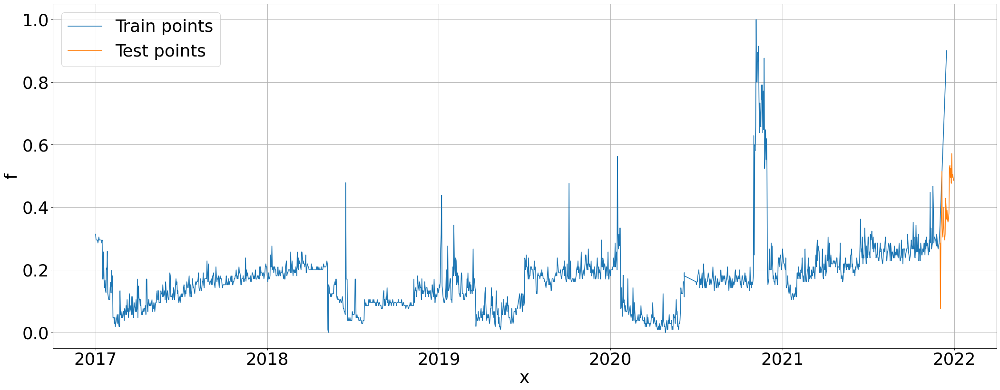

In [57]:
train_X, train_Y = np.array(train.index).reshape(-1, 1), np.array(train['SO2']).reshape(-1, 1)
test_X, test_Y = np.array(test.index).reshape(-1, 1), np.array(test['SO2']).reshape(-1, 1)

# Plot observations
plt.figure(figsize=(32, 12), dpi=80)
plt.plot(np.array(DKI1['Tanggal'].loc[train_X.flatten()]).reshape(-1,1), train_Y, mew=2, label='Train points')
plt.plot(np.array(DKI1['Tanggal'].loc[test_X.flatten()]).reshape(-1,1), test_Y, mew=2, label='Test points')

# Annotate plot
plt.xlabel("x"), plt.ylabel("f")
plt.grid()
plt.legend()

#### Kernel
Optimizing kernel parameters

In [58]:
k1 = GPy.kern.RBF(1)
# k1.variance = 0.175
# k1.lengthscale = 22.44
m1 = GPy.models.GPRegression(train_X, train_Y, k1)
# m1.Gaussian_noise = 0.0055
# m1.Gaussian_noise = 0
# m1.Gaussian_noise.fix()

# Make a gamma prior and set it as the prior for the lengthscale
# gamma_prior = GPy.priors.Gamma.from_EV(1.5, 0.7)
# gamma_prior.plot()
# m1.rbf.lengthscale.set_prior(gamma_prior)

m1.optimize(messages=1, ipython_notebook=True)

In [59]:
plt.rc('figure', figsize=(64, 24), dpi=240)
m1.plot()
ax = plt.gca()
ax.plot(train_X, train_Y, color="green", mew=2, label="Train points")
ax.plot(test_X, test_Y, color="orange", mew=2, label="Test points")
# ax.plot(test_X, test_Y, "mo", mew=2, label="Test points")

ax.legend()

In [60]:
from sklearn import metrics

def print_evaluate(true, predicted):  
    mae = metrics.mean_absolute_error(true, predicted)
    mse = metrics.mean_squared_error(true, predicted)
    rmse = np.sqrt(metrics.mean_squared_error(true, predicted))
    r2_square = metrics.r2_score(true, predicted)
    mape = metrics.mean_absolute_percentage_error(true,predicted)
    print('MAE:', mae)
    print('MSE:', mse)
    print('RMSE:', rmse)
    print('MAPE:', mape)

    print('R2 Square', r2_square)
    print('__________________________________')

In [61]:
print('Evaluation:\n_____________________________________')
print_evaluate(test_Y.flatten(), m1.predict(test_X)[0].flatten())

Evaluation:
_____________________________________
MAE: 0.2668655257571587
MSE: 0.09805693597871015
RMSE: 0.3131404413018385
MAPE: 0.8158775917277911
R2 Square -8.093092094922016
__________________________________


In [62]:
metrics.r2_score(train_Y.flatten(), m1.predict(train_X)[0].flatten())

0.9067211208417268

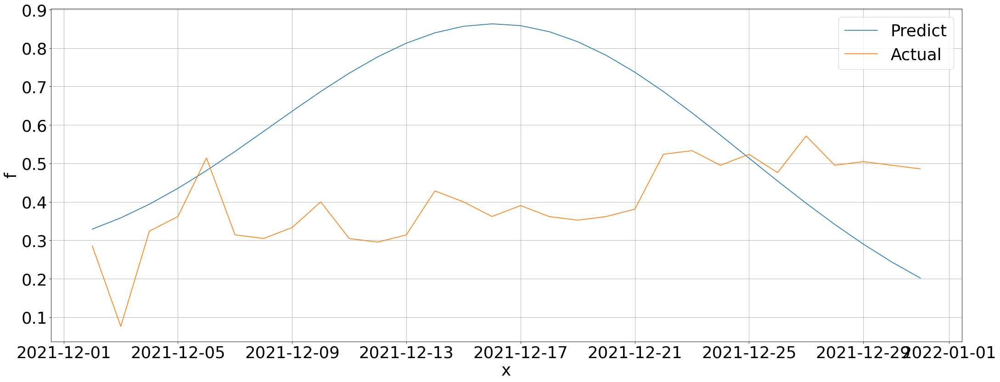

In [63]:
# Plot observations
plt.figure(figsize=(32, 12), dpi=80)
plt.plot(np.array(DKI1['Tanggal'].loc[test_X.flatten()]).reshape(-1,1), m1.predict(test_X)[0], mew=2, label='Predict')
plt.plot(np.array(DKI1['Tanggal'].loc[test_X.flatten()]).reshape(-1,1), test_Y, mew=2, label='Actual')

# Annotate plot
plt.xlabel("x"), plt.ylabel("f")
plt.grid()
plt.legend()

In [64]:
# Denormalisasi
max = 86.0
min = 4.0
test_Y_denorm = (test_Y.flatten() * (max - min) + min)
prediksi_denorm = (m1.predict(test_X)[0].flatten() * (max - min) + min)
metrics.r2_score(test_Y_denorm, prediksi_denorm)

-8.093092094922014

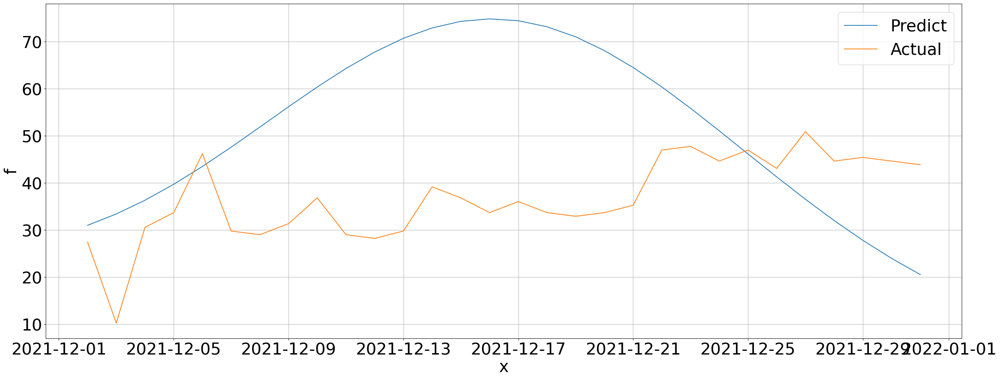

In [65]:
# Plot observations
plt.figure(figsize=(32, 12), dpi=80)
plt.plot(np.array(DKI1['Tanggal'].loc[test_X.flatten()]).reshape(-1,1), prediksi_denorm, mew=2, label='Predict')
plt.plot(np.array(DKI1['Tanggal'].loc[test_X.flatten()]).reshape(-1,1), test_Y_denorm, mew=2, label='Actual')

# Annotate plot
plt.xlabel("x"), plt.ylabel("f")
plt.grid()
plt.legend()

In [66]:
data_test = pd.DataFrame(test_Y_denorm, columns=['Data Test'])
prediksi = pd.DataFrame(prediksi_denorm, columns=['Prediksi'])
selisih = abs(test_Y_denorm.flatten() - prediksi_denorm.flatten())
selisih = pd.DataFrame(selisih, columns=['Selisih'])
pd.concat([data_test, prediksi, selisih], axis=1, join='inner')

,Data Test,Prediksi,Selisih
0,27.428571,30.986797,3.558226
1,10.247619,33.389249,23.141630
2,30.552381,36.303887,5.751506
3,33.676190,39.688046,6.011855
4,46.171429,43.471633,2.699796
5,29.771429,47.557876,17.786447
6,28.990476,51.825855,22.835379
7,31.333333,56.134873,24.801540
8,36.800000,60.330548,23.530548
9,28.990476,64.252315,35.261839


Periodic kernel

In [67]:
k2 = GPy.kern.StdPeriodic(1, period=2)
m2 = GPy.models.GPRegression(train_X, train_Y, k2)
m2.optimize(messages=1, ipython_notebook=True)

In [68]:
plt.rc('figure', figsize=(64, 24), dpi=240)
m2.plot()
ax = plt.gca()
ax.plot(train_X, train_Y, color="green", mew=2, label="Train points")
ax.plot(test_X, test_Y, color="orange", mew=2, label="Test points")
# ax.plot(test_X, test_Y, "mo", mew=2, label="Test points")

ax.legend()

In [69]:
print('Evaluation:\n_____________________________________')
print_evaluate(test_Y, m2.predict(test_X)[0].flatten())

Evaluation:
_____________________________________
MAE: 0.13070654216561753
MSE: 0.024407102726638093
RMSE: 0.15622772713778466
MAPE: 0.36184415936830583
R2 Square -1.263338443613296
__________________________________


In [70]:
metrics.r2_score(train_Y.flatten(), m2.predict(train_X)[0].flatten())

0.2192030296659211

Kernel White

In [71]:
k3 = GPy.kern.White(1)
m3 = GPy.models.GPRegression(train_X, train_Y, k3)
m3.optimize(messages=1, ipython_notebook=True)

In [72]:
plt.rc('figure', figsize=(64, 24), dpi=240)
m3.plot()
ax = plt.gca()
ax.plot(train_X, train_Y, color="green", mew=2, label="Train points")
ax.plot(test_X, test_Y, color="orange", mew=2, label="Test points")
# ax.plot(test_X, test_Y, "mo", mew=2, label="Test points")

ax.legend()

In [73]:
print('Evaluation:\n_____________________________________')
print_evaluate(test_Y, m3.predict(test_X)[0].flatten())

Evaluation:
_____________________________________
MAE: 0.3990476190476187
MSE: 0.17002267573696114
RMSE: 0.4123380600150332
MAPE: 1.0
R2 Square -14.766675077802969
__________________________________


In [74]:
metrics.r2_score(train_Y.flatten(), m3.predict(train_X)[0].flatten())

-2.6333991668348853

Linear

In [75]:
k4 = GPy.kern.Linear(1)
m4 = GPy.models.GPRegression(train_X, train_Y, k4)
m4.optimize(messages=1, ipython_notebook=True)

In [76]:
plt.rc('figure', figsize=(64, 24), dpi=240)
m4.plot()
ax = plt.gca()
ax.plot(train_X, train_Y, color="green", mew=2, label="Train points")
ax.plot(test_X, test_Y, color="orange", mew=2, label="Test points")
# ax.plot(test_X, test_Y, "mo", mew=2, label="Test points")

ax.legend()

In [77]:
print('Evaluation:\n_____________________________________')
print_evaluate(test_Y, m4.predict(test_X)[0].flatten())

Evaluation:
_____________________________________
MAE: 0.12897175560172122
MSE: 0.02386505918330578
RMSE: 0.1544832003271093
MAPE: 0.357887919754201
R2 Square -1.2130732399356212
__________________________________


In [78]:
metrics.r2_score(train_Y.flatten(), m4.predict(train_X)[0].flatten())

-0.1340301948685254

Exponential

In [79]:
k5 = GPy.kern.Exponential(1)
m5 = GPy.models.GPRegression(train_X, train_Y, k5)
m5.optimize(messages=1, ipython_notebook=True)

In [80]:
plt.rc('figure', figsize=(64, 24), dpi=240)
m5.plot()
ax = plt.gca()
ax.plot(train_X, train_Y, color="green", mew=2, label="Train points")
ax.plot(test_X, test_Y, color="orange", mew=2, label="Test points")
# ax.plot(test_X, test_Y, "mo", mew=2, label="Test points")

ax.legend()

In [81]:
print('Evaluation:\n_____________________________________')
print_evaluate(test_Y, m5.predict(test_X)[0].flatten())

Evaluation:
_____________________________________
MAE: 0.2960619238066911
MSE: 0.10820445789484741
RMSE: 0.3289444601978386
MAPE: 0.8834941454208808
R2 Square -9.03409999403391
__________________________________


In [82]:
metrics.r2_score(train_Y.flatten(), m5.predict(train_X)[0].flatten())

0.9999999999874696

Matern32

In [83]:
k6 = GPy.kern.Matern32(1)
m6 = GPy.models.GPRegression(train_X, train_Y, k6)
m6.optimize(messages=1, ipython_notebook=True)

In [84]:
plt.rc('figure', figsize=(64, 24), dpi=240)
m6.plot()
ax = plt.gca()
ax.plot(train_X, train_Y, color="green", mew=2, label="Train points")
ax.plot(test_X, test_Y, color="orange", mew=2, label="Test points")
# ax.plot(test_X, test_Y, "mo", mew=2, label="Test points")

ax.legend()

In [85]:
print('Evaluation:\n_____________________________________')
print_evaluate(test_Y, m6.predict(test_X)[0].flatten())

Evaluation:
_____________________________________
MAE: 0.3269199563226096
MSE: 0.1265692249551441
RMSE: 0.35576568827691085
MAPE: 0.9423002552534613
R2 Square -10.737115864500485
__________________________________


In [86]:
metrics.r2_score(train_Y.flatten(), m6.predict(train_X)[0].flatten())

0.9177844905309844

Matern52

In [87]:
k7 = GPy.kern.Matern52(1)
m7 = GPy.models.GPRegression(train_X, train_Y, k7)
m7.optimize(messages=1, ipython_notebook=True)

In [88]:
plt.rc('figure', figsize=(64, 24), dpi=240)
m7.plot()
ax = plt.gca()
ax.plot(train_X, train_Y, color="green", mew=2, label="Train points")
ax.plot(test_X, test_Y, color="orange", mew=2, label="Test points")
# ax.plot(test_X, test_Y, "mo", mew=2, label="Test points")

ax.legend()

In [89]:
print('Evaluation:\n_____________________________________')
print_evaluate(test_Y, m7.predict(test_X)[0].flatten())

Evaluation:
_____________________________________
MAE: 0.2895024662947162
MSE: 0.10868652693842629
RMSE: 0.32967639730260684
MAPE: 0.8656946398852519
R2 Square -9.078803595728393
__________________________________


In [90]:
metrics.r2_score(train_Y.flatten(), m7.predict(train_X)[0].flatten())

0.9118996518555931

Brownian

In [91]:
k8 = GPy.kern.Brownian(1)
m8 = GPy.models.GPRegression(train_X, train_Y, k8)
m8.optimize(messages=1, ipython_notebook=True)

In [92]:
plt.rc('figure', figsize=(64, 24), dpi=240)
m8.plot()
ax = plt.gca()
ax.plot(train_X, train_Y, color="green", mew=2, label="Train points")
ax.plot(test_X, test_Y, color="orange", mew=2, label="Test points")
# ax.plot(test_X, test_Y, "mo", mew=2, label="Test points")

ax.legend()

In [93]:
print('Evaluation:\n_____________________________________')
print_evaluate(test_Y, m8.predict(test_X)[0].flatten())

Evaluation:
_____________________________________
MAE: 0.32428556224884975
MSE: 0.1203157008869629
RMSE: 0.3468655371854675
MAPE: 0.9360886098634176
R2 Square -10.15720920412789
__________________________________


In [94]:
metrics.r2_score(train_Y.flatten(), m8.predict(train_X)[0].flatten())

0.9469218453940497

Bias

In [95]:
k9 = GPy.kern.Bias(1)
m9 = GPy.models.GPRegression(train_X, train_Y, k9)
m9.optimize(messages=1, ipython_notebook=True)

In [96]:
plt.rc('figure', figsize=(64, 24), dpi=240)
m9.plot()
ax = plt.gca()
ax.plot(train_X, train_Y, color="green", mew=2, label="Train points")
ax.plot(test_X, test_Y, color="orange", mew=2, label="Test points")
# ax.plot(test_X, test_Y, "mo", mew=2, label="Test points")

ax.legend()

In [97]:
print('Evaluation:\n_____________________________________')
print_evaluate(test_Y, m9.predict(test_X)[0].flatten())

Evaluation:
_____________________________________
MAE: 0.2382343305110424
MSE: 0.06469579708660984
RMSE: 0.25435368502659805
MAPE: 0.5953266406670167
R2 Square -4.999421001597047
__________________________________


In [98]:
metrics.r2_score(train_Y.flatten(), m9.predict(train_X)[0].flatten())

-1.1771931851534134e-07

Periodik Eksponensial

In [99]:
k10 = GPy.kern.PeriodicExponential(1)
m10 = GPy.models.GPRegression(train_X, train_Y, k10)
m10.optimize(messages=1, ipython_notebook=True)

In [100]:
plt.rc('figure', figsize=(64, 24), dpi=240)
m10.plot()
ax = plt.gca()
ax.plot(train_X, train_Y, color="green", mew=2, label="Train points")
ax.plot(test_X, test_Y, color="orange", mew=2, label="Test points")
# ax.plot(test_X, test_Y, "mo", mew=2, label="Test points")

ax.legend()

In [101]:
print('Evaluation:\n_____________________________________')
print_evaluate(test_Y, m10.predict(test_X)[0].flatten())

Evaluation:
_____________________________________
MAE: 0.39904761903388425
MSE: 0.1700226757249246
RMSE: 0.41233806000043777
MAPE: 0.9999999998805529
R2 Square -14.766675076686786
__________________________________


In [102]:
metrics.r2_score(train_Y.flatten(), m10.predict(train_X)[0].flatten())

-2.6333991667442924

Plot hasil semua

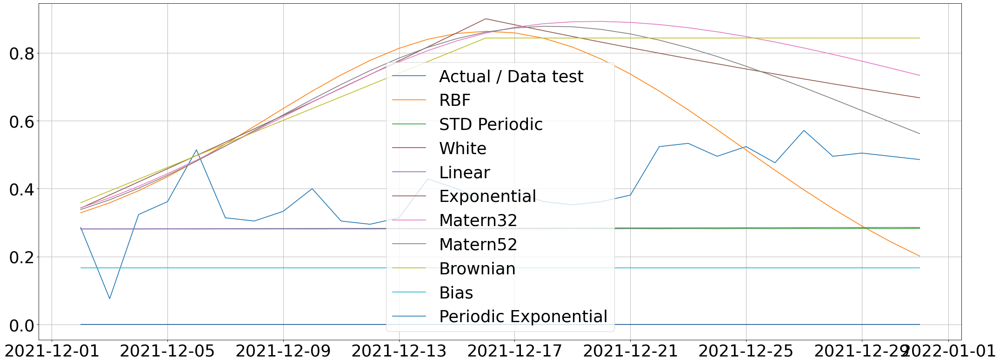

In [103]:
# Plot observations
plt.figure(figsize=(32, 12), dpi=80)
plt.plot(np.array(DKI1['Tanggal'].loc[test_X.flatten()]).reshape(-1,1), test_Y, mew=2, label='Actual / Data test')
plt.plot(np.array(DKI1['Tanggal'].loc[test_X.flatten()]).reshape(-1,1), m1.predict(test_X)[0], mew=2, label='RBF')
plt.plot(np.array(DKI1['Tanggal'].loc[test_X.flatten()]).reshape(-1,1), m2.predict(test_X)[0], mew=2, label='STD Periodic')
plt.plot(np.array(DKI1['Tanggal'].loc[test_X.flatten()]).reshape(-1,1), m3.predict(test_X)[0], mew=2, label='White')
plt.plot(np.array(DKI1['Tanggal'].loc[test_X.flatten()]).reshape(-1,1), m4.predict(test_X)[0], mew=2, label='Linear')
plt.plot(np.array(DKI1['Tanggal'].loc[test_X.flatten()]).reshape(-1,1), m5.predict(test_X)[0], mew=2, label='Exponential')
plt.plot(np.array(DKI1['Tanggal'].loc[test_X.flatten()]).reshape(-1,1), m6.predict(test_X)[0], mew=2, label='Matern32')
plt.plot(np.array(DKI1['Tanggal'].loc[test_X.flatten()]).reshape(-1,1), m7.predict(test_X)[0], mew=2, label='Matern52')
plt.plot(np.array(DKI1['Tanggal'].loc[test_X.flatten()]).reshape(-1,1), m8.predict(test_X)[0], mew=2, label='Brownian')
plt.plot(np.array(DKI1['Tanggal'].loc[test_X.flatten()]).reshape(-1,1), m9.predict(test_X)[0], mew=2, label='Bias')
plt.plot(np.array(DKI1['Tanggal'].loc[test_X.flatten()]).reshape(-1,1), m10.predict(test_X)[0], mew=2, label='Periodic Exponential')

# Annotate plot
# plt.xlabel("x"), plt.ylabel("y")
plt.grid()
plt.legend()